In [1]:
import pandas as pd
import altair as alt
import matplotlib.pyplot as plt
import numpy as np
import math

In [2]:
alt.renderers.enable('notebook')
alt.data_transformers.enable('default', max_rows=None) 
pd.set_option('display.max_columns', 35)

#### Read and prepare data

In [3]:
music = pd.read_csv('music.csv')
print("Dataset shape:", music.shape)

Dataset shape: (10000, 35)


In [4]:
music = music.rename(columns={'artist.hotttnesss':'artist_hotttnesss','song.hotttnesss':'song_hotttnesss'})

#### Take a look at the data

In [5]:
music.head()

,artist_hotttnesss,artist.id,artist.name,artist_mbtags,artist_mbtags_count,bars_confidence,bars_start,beats_confidence,beats_start,duration,end_of_fade_in,familiarity,key,key_confidence,latitude,location,longitude,loudness,mode,mode_confidence,release.id,release.name,similar,song_hotttnesss,song.id,start_of_fade_out,tatums_confidence,tatums_start,tempo,terms,terms_freq,time_signature,time_signature_confidence,title,year
0,0.401998,ARD7TVE1187B99BFB1,Casual,NaN,0.0,0.643,0.58521,0.834,0.58521,218.93179,0.247,0.581794,1.0,0.736,37.157357,California - LA,-63.933358,-11.197,0,0.636,300848,Fear Itself,ARV4KO21187FB38008,0.602120,SOMZWCG12A8C13C480,218.932,0.779,0.28519,92.198,hip hop,1.000000,4.0,0.778,I Didn't Mean To,0
1,0.417500,ARMJAGH1187FB546F3,The Box Tops,classic pop and rock,1.0,0.007,0.71054,1.000,0.20627,148.03546,0.148,0.630630,6.0,0.169,35.149680,"Memphis, TN",-90.048920,-9.843,0,0.430,300822,Dimensions,ARSZWK21187B9B26D7,NaN,SOCIWDW12A8C13D406,137.915,0.969,0.20627,121.274,blue-eyed soul,1.000000,4.0,0.384,Soul Deep,1969
2,0.343428,ARKRRTF1187B9984DA,Sonora Santanera,NaN,0.0,0.980,0.73152,0.980,0.73152,177.47546,0.282,0.487357,8.0,0.643,37.157357,Not available,-63.933358,-9.689,1,0.565,514953,Las Numero 1 De La Sonora Santanera,ARFSJUG11C8A421AAD,NaN,SOXVLOJ12AB0189215,172.304,0.482,0.42132,100.070,salsa,1.000000,1.0,0.000,Amor De Cabaret,0
3,0.454231,AR7G5I41187FB4CE6C,Adam Ant,uk,1.0,0.017,1.30621,0.809,0.81002,233.40363,0.000,0.630382,0.0,0.751,37.157357,"London, England",-63.933358,-9.013,1,0.749,287650,Friend Or Foe,AR4R0741187FB39AF2,NaN,SONHOTT12A8C13493C,217.124,0.601,0.56254,119.293,pop rock,0.988584,4.0,0.000,Something Girls,1982
4,0.401724,ARXR32B1187FB57099,Gob,NaN,0.0,0.175,1.06368,0.883,0.13576,209.60608,0.066,0.651046,2.0,0.092,37.157357,Not available,-63.933358,-4.501,1,0.371,611336,Muertos Vivos,ARUA62A1187B99D9B0,0.604501,SOFSOCN12A8C143F5D,198.699,1.000,0.13576,129.738,pop punk,0.887288,4.0,0.562,Face the Ashes,2007


#### Check data structure

In [6]:
music.dtypes

artist_hotttnesss            float64
artist.id                     object
artist.name                   object
artist_mbtags                 object
artist_mbtags_count          float64
bars_confidence              float64
bars_start                   float64
beats_confidence             float64
beats_start                  float64
duration                     float64
end_of_fade_in               float64
familiarity                  float64
key                          float64
key_confidence               float64
latitude                     float64
location                      object
longitude                    float64
loudness                     float64
mode                           int64
mode_confidence              float64
release.id                     int64
release.name                  object
similar                       object
song_hotttnesss              float64
song.id                       object
start_of_fade_out            float64
tatums_confidence            float64
t

[Data explanation](https://labrosa.ee.columbia.edu/millionsong/pages/example-track-description)

#### Check data summary

In [7]:
music.describe()

,artist_hotttnesss,artist_mbtags_count,bars_confidence,bars_start,beats_confidence,beats_start,duration,end_of_fade_in,familiarity,key,key_confidence,latitude,longitude,loudness,mode,mode_confidence,release.id,song_hotttnesss,start_of_fade_out,tatums_confidence,tatums_start,tempo,terms_freq,time_signature,time_signature_confidence,year
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,9996.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,5649.000000,10000.000000,10000.000000,10000.000000,10000.000000,1.000000e+04,10000.000000,10000.000000,10000.000000
mean,0.385552,0.524686,0.239595,1.065246,0.613963,0.428497,240.622038,0.756708,0.565456,5.366580,0.451458,37.157357,-63.933358,-10.483529,0.691000,0.477765,371024.058400,0.342761,229.883436,0.507875,0.299886,122.900913,2.248903e+02,3.564443,0.599785,934.704600
std,0.143647,0.884095,0.288259,1.723468,0.322441,0.806217,246.084090,1.858958,0.160161,9.671788,0.332143,9.541095,30.894250,5.399704,0.462104,0.191269,236777.828209,0.247240,112.024303,0.332357,0.510925,35.204746,2.239216e+04,1.266620,8.991567,996.650657
min,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,1.044440,0.000000,0.000000,0.000000,0.000000,-41.280540,-162.436500,-51.643000,0.000000,0.000000,0.000000,0.000000,-21.394000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000
25%,0.325266,0.000000,0.035000,0.441590,0.409750,0.194655,176.032200,0.000000,0.467611,2.000000,0.225000,37.157357,-73.948880,-13.160000,0.000000,0.360000,172858.000000,0.000000,168.855750,0.237000,0.110692,96.959500,9.476125e-01,3.000000,0.097750,0.000000
50%,0.380742,0.000000,0.120000,0.785460,0.686000,0.332585,223.059140,0.199000,0.563666,5.000000,0.469000,37.157357,-63.933358,-9.379500,1.000000,0.487000,333103.000000,0.360371,213.864500,0.500000,0.191520,120.156500,9.999728e-01,4.000000,0.551000,0.000000
75%,0.453858,1.000000,0.351000,1.224075,0.882000,0.500753,276.375060,0.421000,0.668020,8.000000,0.659000,37.157357,-63.933358,-6.530750,1.000000,0.606000,573532.500000,0.537504,266.274750,0.774250,0.294743,144.006750,1.000000e+00,4.000000,0.864000,2000.000000
max,1.082503,9.000000,8.855240,59.743540,1.000000,12.245830,22050.000000,43.119000,1.000000,904.802810,19.081000,69.651020,174.767140,0.566000,1.000000,1.000000,823599.000000,1.000000,1813.426000,9.227560,12.245830,262.828000,2.239217e+06,7.000000,898.891000,2010.000000


#### What questions can we ask?

1. Does an artist's hotness correlate with the hotnesses of his songs?
2. How do the songs hotness, duration, loudness, tempo change with years?
3. How do the most popular terms (genres) change in time?
4. What are the mose frequent tempos in terms?

## Question #1

#### Does an artist's hotness correlate with the hotnesses of his songs?

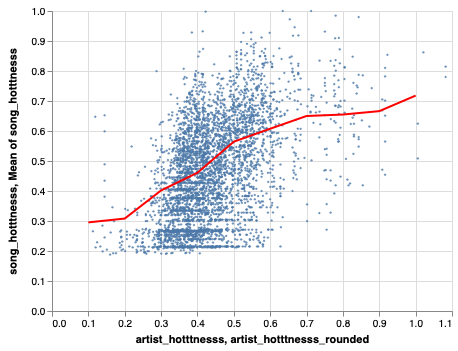

In [8]:
songs_with_hotness = music[music['song_hotttnesss'] > 0]
songs_with_hotness = songs_with_hotness[songs_with_hotness['artist_hotttnesss'] > 0.02]

scatter = alt.Chart(songs_with_hotness).mark_circle(opacity=0.8, size=6).encode(
    x = 'artist_hotttnesss',
    y = 'song_hotttnesss'
)

songs_with_hotness['artist_hotttnesss_rounded'] = (10 * songs_with_hotness['artist_hotttnesss']).astype(int) / 10.0

line = alt.Chart(songs_with_hotness).mark_line(color='red').encode(
    x = 'artist_hotttnesss_rounded',
    y = alt.Y('song_hotttnesss', aggregate='mean')
)

scatter + line

In [9]:
# although each song separately does not correlate with artists' hotness, 
# at average all song highly correlate with it.

## Question #2

#### How do the songs hotness, duration, loudness, tempo change with years?

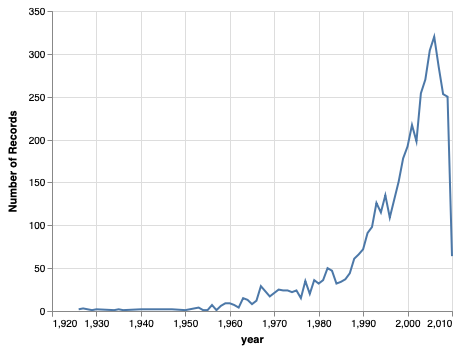

In [10]:
# we omit all songs without a year
yearly = music[music['year'] > 0]

# lets look how many songs are each year
alt.Chart(yearly).mark_line().encode(
    x = 'year',
    y = 'count()'
)

In [11]:
# We cannot say that 20 songs per year are very representative. 
# Let's count only years that have 50 songs and bigger count (1990+).
yearly = yearly[yearly['year'] >= 1990]

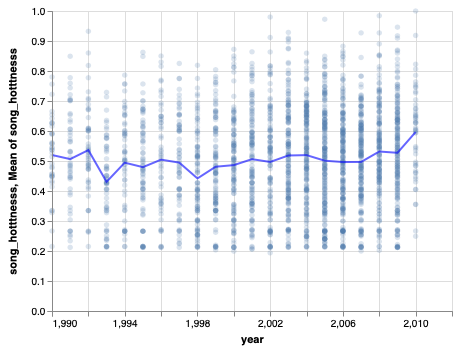

In [12]:
# let's look at hotness at average by year

yearly_hotness = yearly[yearly['song_hotttnesss'] > 0]

scatter = alt.Chart(yearly_hotness).mark_circle(opacity=0.2).encode(
    x = alt.X('year', scale=alt.Scale(domain=(1990,2012))),
    y = alt.Y('song_hotttnesss', scale=alt.Scale(domain=(0,1)))
)

line = alt.Chart(yearly_hotness).mark_line(color = 'blue', opacity=0.6).encode(
    x = alt.X('year', scale=alt.Scale(domain=(1990,2012))),
    y = alt.Y('song_hotttnesss', scale=alt.Scale(domain=(0,1)), aggregate='mean')
)

scatter + line

In [13]:
# as we see, the hotness doesn't change a lot from year to year,
# hovewer, we can observe relatively large hotness decrease in 1993

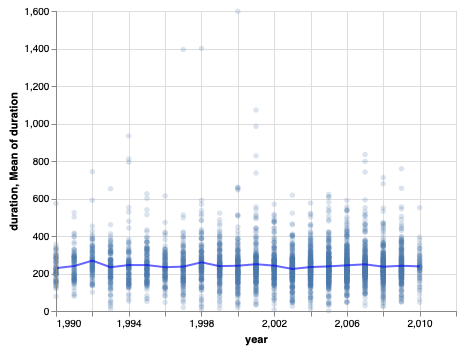

In [14]:
scatter = alt.Chart(yearly).mark_circle(opacity=0.2).encode(
    x = alt.X('year', scale=alt.Scale(domain=(1990,2012))),
    y = 'duration'
)

line = alt.Chart(yearly).mark_line(color = 'blue', opacity=0.6).encode(
    x = alt.X('year', scale=alt.Scale(domain=(1990,2012))),
    y = alt.Y('duration', aggregate='mean')
)

scatter + line

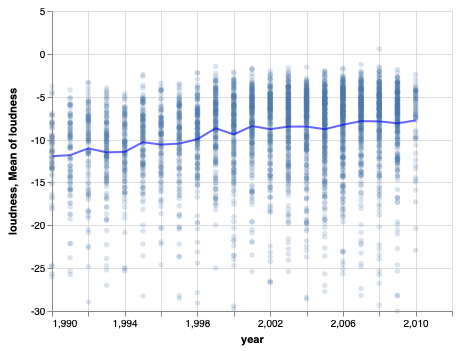

In [15]:
# let's look at song loudness at average by year

yearly_loudness = yearly[yearly['loudness'] > -30]

scatter = alt.Chart(yearly_loudness).mark_circle(opacity=0.2).encode(
    x = alt.X('year', scale=alt.Scale(domain=(1990,2012))),
    y = 'loudness'
)

line = alt.Chart(yearly_loudness).mark_line(color = 'blue', opacity=0.6).encode(
    x = alt.X('year', scale=alt.Scale(domain=(1990,2012))),
    y = alt.Y('loudness', aggregate='mean')
)

scatter + line

In [16]:
# as we see, the loudness increases every year

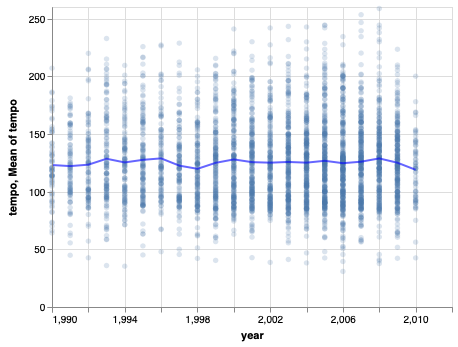

In [17]:
# let's look at song tempo at average by year
yearly_tempo = yearly[yearly['tempo'] > 0]


scatter = alt.Chart(yearly_tempo).mark_circle(opacity=0.2).encode(
    x = alt.X('year', scale=alt.Scale(domain=(1990,2012))),
    y = 'tempo'
)

line = alt.Chart(yearly_tempo).mark_line(color = 'blue', opacity=0.6).encode(
    x = alt.X('year', scale=alt.Scale(domain=(1990,2012))),
    y = alt.Y('tempo', aggregate='mean')
)

scatter + line

In [18]:
# we observe no change in tempo
# hovewer, in 1998 there was a trend for songs with lower tempo

## Question #3

#### How do the most popular terms (genres) change in time?

In [19]:
# let's take most popular genres
terms_sorted = list(music.groupby('terms').count().sort_values(by='title', ascending=False).index)
terms = np.take(terms_sorted, range(0,15))
terms

array(['blues-rock', 'hip hop', 'ccm', 'chanson', 'country rock',
       'latin jazz', 'post-grunge', 'dance pop', 'gangster rap',
       'roots reggae', 'pop rock', 'progressive house', 'dancehall',
       'heavy metal', 'power pop'], dtype='<U40')

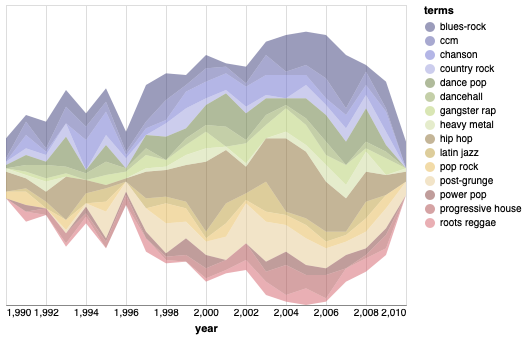

In [20]:
music_terms = yearly[list(map(lambda term: term in terms, yearly['terms']))]

alt.Chart(music_terms).mark_area(opacity=0.5).encode(
    x = alt.X('year', axis=alt.Axis(tickSize=0), scale=alt.Scale(domain=(1990,2010))),
    y = alt.Y('count()', stack='center', axis=None),
    color = alt.Color('terms', scale=alt.Scale(scheme='category20b'))
)

## I'm still working on it...